In [310]:
from sqlalchemy import create_engine
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import seaborn as sns

username = "i-can-only-read-gmx-data"
password = "house-football-checksum-11"
host = "34.77.163.253"
database = "dojo_data"
port = "5432"

engine = create_engine(f"postgresql+psycopg2://{username}:{password}@{host}:{port}/{database}")

query_eth_event = "SELECT * FROM hackathon_ethereum_events ORDER BY md5(block_timestamp::text) LIMIT 100000"
query_arb_event = "SELECT * FROM hackathon_arbitrum_events ORDER BY md5(block_timestamp::text) LIMIT 100000"
df_eth_event = pd.read_sql(query_eth_event, engine)
df_arb_event = pd.read_sql(query_arb_event, engine)

In [311]:
print(f"Distinct number of events:")
df_arb_event["event_name"].value_counts()

Distinct number of events:


event_name
EventLog1    41027
Swap         37471
EventLog2    13060
Mint          2793
Burn          2742
Collect       2721
EventLog       184
Flash            2
Name: count, dtype: int64

In [318]:
def find_event_ratio(df):
    event_freq = df["event_name"].value_counts().values
    event_ratio = df["event_name"].value_counts() / sum(event_freq)
    others = []
    for i, j in event_ratio.items():
        if j < 0.02:
            others.append(j)
            event_ratio.drop(index=i, inplace=True)

    event_ratio = pd.concat([event_ratio, pd.Series([sum(others)], index=['others'])])
    return event_ratio

eth_ratio_event = find_event_ratio(df_eth_event)
arb_ratio_event = find_event_ratio(df_arb_event)

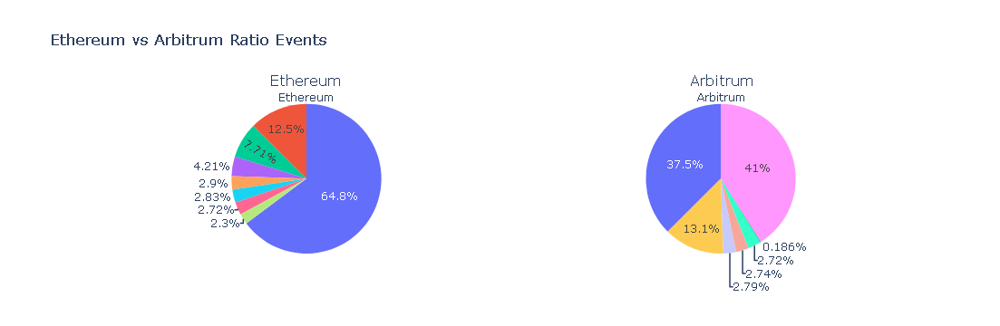

In [320]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'pie'}, {'type': 'pie'}]],
                    subplot_titles=("Ethereum", "Arbitrum"))

fig.add_trace(go.Pie(labels=list(eth_ratio_event.index),
                     values=list(eth_ratio_event.values),
                     hole=0,
                     title="Ethereum",
                     textinfo='percent'),
              row=1, col=1)

fig.add_trace(go.Pie(labels=list(arb_ratio_event.index),
                     values=list(arb_ratio_event.values),
                     hole=0,
                     title="Arbitrum",
                     textinfo='percent'),
              row=1, col=2)

fig.update_layout(title_text="Ethereum vs Arbitrum Ratio Events", showlegend=False)
fig.show()

We can see that for Ethereum, Swap is the most prominent event, for Arbitrum it's more equally dsitributed. But the sample may introduce biases.

In [322]:
mlist = []
for x, y in zip(df_eth_event["event_data"], df_eth_event["event_name"]):
    if isinstance(x, dict):
        x_str = ' + '.join(list(x.keys()))
        mlist.append(y + ': ' + x_str)
    else:
        y.append(y + ': ' + x)

print("distinct events and thier data")
set(mlist)

distinct events and thier data


{'Borrow: reserve + onBehalfOf + referralCode + user + amount + interestRateMode + borrowRate',
 'Burn: owner + tickLower + tickUpper + amount + amount0 + amount1',
 'Collect: owner + tickLower + tickUpper + recipient + amount0 + amount1',
 'Flash: sender + recipient + amount0 + amount1 + paid0 + paid1',
 'FlashLoan: target + asset + referralCode + initiator + amount + interestRateMode + premium',
 'IsolationModeTotalDebtUpdated: asset + totalDebt',
 'LiquidationCall: collateralAsset + debtAsset + user + debtToCover + liquidatedCollateralAmount + liquidator + receiveAToken',
 'Mint: owner + tickLower + tickUpper + sender + amount + amount0 + amount1',
 'MintedToTreasury: reserve + amountMinted',
 'Repay: reserve + user + repayer + amount + useATokens',
 'ReserveDataUpdated: reserve + liquidityRate + stableBorrowRate + variableBorrowRate + liquidityIndex + variableBorrowIndex',
 'ReserveUsedAsCollateralDisabled: reserve + user',
 'ReserveUsedAsCollateralEnabled: reserve + user',
 'Suppl

In [324]:
def plot_3d(swap_events):
    liquidity = []
    sqrtPriceX96 = []
    trade_volume = []
    tick = []
    
    for x in swap_events["event_data"].values:
        liquidity.append(x["liquidity"])
        sqrtPriceX96.append(x["sqrtPriceX96"])
        trade_volume.append(abs(x["amount0"]) + abs(x["amount1"]))
        tick.append(x["tick"])
    
    liquidity = np.array(liquidity).reshape(-1, 1)
    sqrtPriceX96 = np.array(sqrtPriceX96).reshape(-1, 1)
    trade_volume = np.array(trade_volume).reshape(-1, 1)
    gas_cost = (swap_events["gas_price"] * swap_events["gas"] / 1e-9).values.reshape(-1, 1)
    
    scaler = MinMaxScaler()
    liquidity_normalized = scaler.fit_transform(liquidity)
    sqrtPriceX96_normalized = scaler.fit_transform(sqrtPriceX96)
    trade_volume_normalized = scaler.fit_transform(trade_volume)
    gas_cost_normalized = scaler.fit_transform(gas_cost)
    
    fig = go.Figure(data=go.Scatter3d(
        x=liquidity_normalized.flatten(),
        y=gas_cost_normalized.flatten(),
        z=sqrtPriceX96_normalized.flatten(),
        mode='markers',
        marker=dict(
            size=5,
            color=trade_volume_normalized.flatten(),  # Use trade_volume_normalized for color
            colorscale='Viridis',
            colorbar=dict(title="Normalized Trade Volume (amount0 + amount1)"),
            opacity=0.7
        )
    ))
    
    fig.update_layout(
        scene=dict(
            xaxis_title="Normalized Liquidity",
            yaxis_title="Normalized Gas Cost (Gwei)",
            zaxis_title="Normalized sqrtPriceX96"
        ),
        title="Comprehensive View of Normalized Swap Events",
        height=800,
        width=1200
    )

    # Show the plot
    fig.show()

In [291]:
swap_event_eth = df_eth_event[df_eth_event["event_name"] == "Swap"]
plot_3d(swap_event_eth)

In [308]:
swap_event_arb = df_arb_event[df_arb_event["event_name"] == "Swap"]
plot_3d(swap_event_arb)

In [302]:
def plot_time(swap_event):
    scaler = MinMaxScaler()
    
    swap_event.loc[:, "gas"] = scaler.fit_transform(swap_event[["gas"]].astype(float))
    swap_event.loc[:, "gas_price"] = scaler.fit_transform(swap_event[["gas_price"]].astype(float))
    swap_event.loc[:, "rolling_gas"] = swap_event["gas"].rolling(window=30).mean()
    swap_event.loc[:, "rolling_gas_price"] = swap_event["gas_price"].rolling(window=30).mean()
    
    # Create the plot
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=swap_event.index,
        y=swap_event["rolling_gas"],
        mode='lines',
        name='Rolling Gas (30-day avg)',
        line=dict(color='red'),
        opacity=0.5
    ))

    fig.add_trace(go.Scatter(
        x=swap_event.index,
        y=swap_event["rolling_gas_price"],
        mode='lines',
        name='Rolling Gas Price (30-day avg)',
        line=dict(color='blue'),
        opacity=0.5
    ))
    
    fig.update_layout(
        title='Rolling Averages of Gas and Gas Price',
        xaxis_title='Date',
        yaxis_title='Normalized Value',
        legend=dict(x=0.01, y=0.99),
        template='plotly'
    )
    
    fig.show()

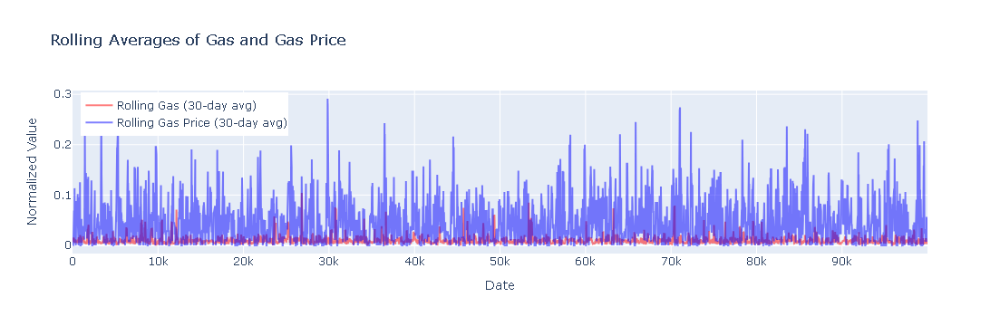

In [304]:
plot_time(swap_event_arb)

The data shows some seasonality on both the gas volume and gas price.

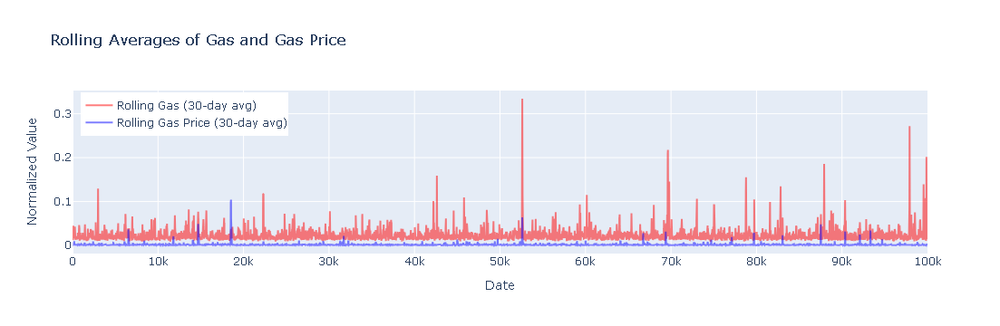

In [306]:
plot_time(swap_event_eth)

The data shows seasonality but there are spikes, this may show that ethereum has more volatility and more speculators